In [1]:
import numpy as np
import pandas as pd
import os 
import matplotlib.pyplot as plt
# import umap
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib

from scroutines import config_plots
from scroutines import basicu
from scroutines import miscu
# from dredFISH.Utils import __init__plots
# from dredFISH.Utils import basicu
# from dredFISH.Utils import miscu

In [2]:
import sys
sys.setrecursionlimit(30000)
from scipy.cluster import hierarchy as sch

In [3]:
pth_dat = '/u/home/f/f7xiesnm/project-zipursky/easifish/lt186/proc/r1-r2-v2/'
!ls $pth_dat

bad_roi_list.npy	    clustering_r1r2_config_230721.json	roi.csv
clustering_r1r2_230831.csv  roi_all.csv				spotcount.csv


In [4]:
gene_names = {
    'r1_c0': "RL (Cre)",
    'r1_c2': "LM (FlpO)",
    
    'r2_c0': 'Sorcs3',
    'r2_c1': 'Kcnq5',
    'r2_c2': 'Chrm2',
    'r2_c4': 'Adamts2',
}
channel_names = pd.Series(gene_names).reset_index().set_index(0)['index']
ftrs_order = list(gene_names.keys())

genes_order = [gene_names[ftr] for ftr in ftrs_order]
genes_order

['RL (Cre)', 'LM (FlpO)', 'Sorcs3', 'Kcnq5', 'Chrm2', 'Adamts2']

In [5]:
f_meta = os.path.join(pth_dat, 'roi.csv')
# f_ftrs = os.path.join(pth_dat, 'spotcount_merged.csv')
f_ftrs = os.path.join(pth_dat, 'spotcount.csv')

In [6]:
meta = pd.read_csv(f_meta, index_col=0)
ftrs = pd.read_csv(f_ftrs, index_col=0)
df = ftrs.join(meta).dropna()
ftrs_cols = ftrs.columns.values
print(meta.shape, ftrs.shape, df.shape)

(28228, 4) (28228, 6) (28228, 10)


In [7]:
max_x, max_y, max_z = df[['x', 'y', 'z']].describe().loc['max']
min_x, min_y, min_z = df[['x', 'y', 'z']].describe().loc['min']
print(f"x: {min_x:.1f}, {max_x:.1f}")
print(f"y: {min_y:.1f}, {max_y:.1f}")
print(f"z: {min_z:.1f}, {max_z:.1f}")
df['to_edge'] = np.minimum(
    np.minimum(df['x']-min_x, max_x-df['x']), 
    np.minimum(df['y']-min_y, max_y-df['y']), 
    np.minimum(df['z']-min_z, max_z-df['z']),
)

for col in ftrs_cols:
    val = df[col].values
    print(f'{col}: {np.min(val):.0f}, {np.max(val):.0f}, {np.sum(val>0)/len(df):.2f}')

x: 4.2, 934.0
y: 26.7, 833.4
z: 8.2, 514.9
r1_c0: 0, 166, 0.34
r1_c2: 0, 97, 0.20
r2_c0: 0, 86, 0.88
r2_c1: 0, 159, 0.76
r2_c2: 0, 70, 0.64
r2_c4: 0, 22, 0.43


In [8]:
########### FLIP z!
df['z'] = max_z -df['z']

# check basics

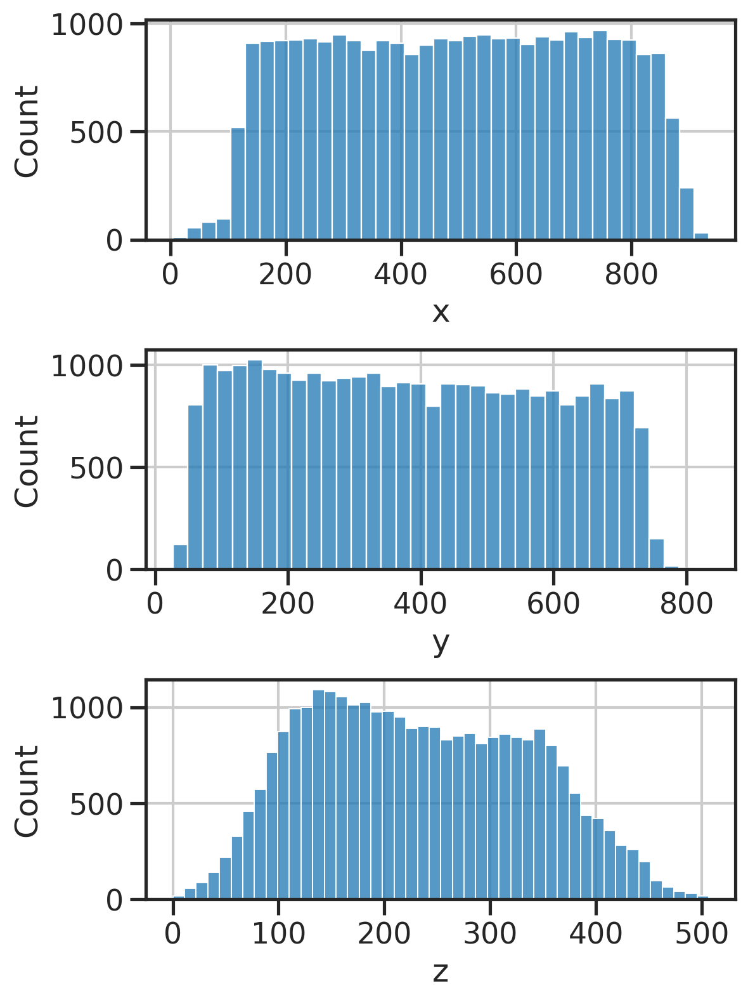

Text(0.5, 0, 'area')

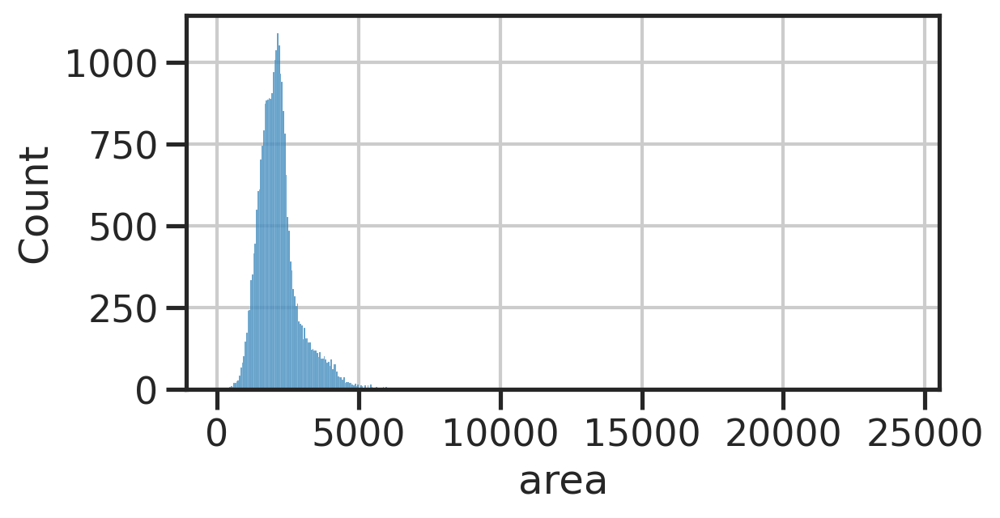

In [9]:
x = df['x'].values
y = df['y'].values
z = df['z'].values

fig, axs = plt.subplots(3, 1, figsize=(1*6, 3*3))
ax = axs[0]
sns.histplot(x, ax=ax)
ax.set_xlabel('x')

ax = axs[1]
sns.histplot(y, ax=ax)
ax.set_xlabel('y')

ax = axs[2]
sns.histplot(z, ax=ax)
ax.set_xlabel('z')

fig.subplots_adjust(hspace=0.5)
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(1*6, 1*3))
sns.histplot(df['area'].values, ax=ax)
ax.set_xlabel('area')

In [10]:
# remove outliers
conds = [
    df['area'] > 500,
    df['area'] < 5000,
    df['x'] > min_x + 100,
    df['x'] < max_x - 100,
    
    df['y'] > min_y + 100,
    df['y'] < max_y - 100,
    
    df['z'] > min_z + 20,
    df['z'] < max_z - 20,
]
cond_all = np.ones(len(df)) > 0
for cond in conds:
    cond_all = np.logical_and(cond_all, cond)
    print(cond_all.sum())
print(len(df), cond_all.sum())

dfnew = df[cond_all].copy()

# size
med_size = dfnew['area'].median()
print(med_size)
size_factor = dfnew['area']/med_size

# norm by size
mat_raw = dfnew[ftrs_cols].values
dfnew[ftrs_cols] = dfnew[ftrs_cols].divide(size_factor, axis=0)
mat_sizenorm = dfnew[ftrs_cols].values

# log2+1 norm
normed_ftrs_cols = np.char.add(ftrs_cols.astype(str) ,'_log2')
dfnew[normed_ftrs_cols] = np.log2(dfnew[ftrs_cols]+1)
mat_log2norm = dfnew[normed_ftrs_cols].values

# zscore
mat_zscore = (mat_log2norm - np.mean(mat_log2norm, axis=0))/np.std(mat_log2norm, axis=0)

28213
28004
27762
26102
23094
22692
22661
22654
28228 22654
2066.807232


In [11]:
mat_ftrs = dfnew.filter(regex='_log2$').filter(regex='^((?!r1).)*$') #.columns
mat_ftrs.columns = [gene_names[col[:-len('_log2')]] for col in mat_ftrs.columns]
mat_ftrs = basicu.zscore(mat_ftrs, axis=0)
mat_ftrs

,Sorcs3,Kcnq5,Chrm2,Adamts2
2,0.966640,-0.273976,-0.256934,1.141068
3,0.568307,0.637511,0.681621,3.016329
6,-0.740763,-0.965017,-1.107001,0.038468
11,0.710999,1.521566,1.014868,0.905778
13,0.388677,-0.728996,-1.107001,0.790772
...,...,...,...,...
28223,1.300083,0.719255,-1.107001,-0.764411
28225,-0.045459,0.260771,2.111421,-0.764411
28226,0.921915,1.733229,1.098890,0.997320
28227,-1.940968,-1.468212,-1.107001,-0.764411


In [12]:
mat_cre = dfnew[['r1_c0_log2', 'r1_c2_log2']]
mat_cre.columns = [gene_names[col[:-len('_log2')]] for col in mat_cre.columns]
mat_cre

,RL (Cre),LM (FlpO)
2,4.566710,0.0
3,0.000000,0.0
6,0.000000,0.0
11,0.000000,0.0
13,0.603664,0.0
...,...,...
28223,0.000000,0.0
28225,0.000000,0.0
28226,0.000000,0.0
28227,0.000000,0.0


In [13]:
# # PCAs
# n_pc = len(genes_order)
# idx_pcs = np.arange(1, n_pc+1)

# pca = PCA(n_components=n_pc)
# pcs = pca.fit_transform(mat_zscore) 
# plt.plot(idx_pcs, pca.explained_variance_ratio_, 'o')
# plt.xticks(idx_pcs)
# plt.ylim(ymin=0)
# plt.axhline(1/n_pc, color='k')
# plt.xlabel('PC')
# plt.ylabel('Explained variance')

# for i in idx_pcs:
#     dfnew[f'PC{i}'] = pcs[:,i-1]

In [14]:
# # UMAPs
# Zspace = umap.UMAP(n_components=2).fit_transform(pcs)
# dfnew['umap_x'] = Zspace[:,0]
# dfnew['umap_y'] = Zspace[:,1]

# # UMAPs more
# nns = [30, 60, 120, 240, 480]
# for nn in nns:
#     Zspace = umap.UMAP(n_components=2, n_neighbors=nn).fit_transform(pcs)
#     dfnew[f'umap_x_nn{nn}'] = Zspace[:,0]
#     dfnew[f'umap_y_nn{nn}'] = Zspace[:,1]

# # clsts
# numclsts = [2, 5, 10]
# for k in numclsts: 
#     model = KMeans(n_clusters=k)
#     clsts = model.fit_predict(pcs)
#     dfnew[f'clsts_k{k}'] = np.char.add("c", clsts.astype(str))

# # clsts
# G = miscu.build_feature_graph_knnlite(pcs, k=15, metric='euclidean')
# rs = [0.01, 0.02, 0.05, 0.1, 1]
# for r in rs:
#     clsts = miscu.leiden(G, dfnew.index.values, resolution=r) 
#     dfnew[f'clsts_r{r}'] = np.char.add("c", np.array(clsts).astype(str))

Text(0.5, 0, 'Genes')

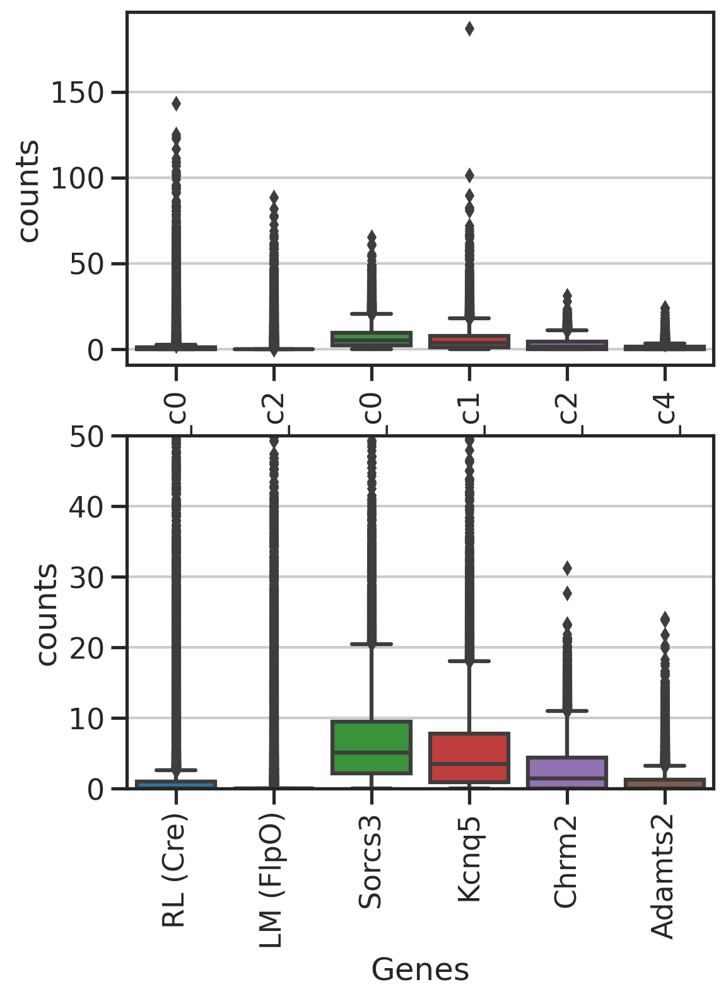

In [15]:
fig, axs = plt.subplots(2, 1, figsize=(6*1,4*2))
ax = axs[0]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

ax = axs[1]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels([gene_names[ftr_col] for ftr_col in ftrs_cols], rotation=90)
ax.set_ylim([0,50])
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

In [16]:
# binary analysis
# ybins = np.linspace(0,400,100)
# dfnew['ybin'] = pd.cut(dfnew['y'], bins=ybins)

# xbins = np.linspace(0,400,100)
# dfnew['xbin'] = pd.cut(dfnew['x'], bins=xbins)

# zbins = np.linspace(0,400,100)
# dfnew['zbin'] = pd.cut(dfnew['z'], bins=zbins)

# bins_zb = np.linspace(0,400,9).astype(int)
# print(bins_zb)
# dfnew['bins_zb'] = pd.cut(dfnew['z'], bins=bins_zb)

# bins_zb_4p = np.linspace(0,400,5).astype(int)
# print(bins_zb_4p)
# dfnew['bins_zb_4p'] = pd.cut(dfnew['z'], bins=bins_zb_4p)


bins_yb = np.linspace(0,max_y,8+1).astype(int)
print(bins_yb)
dfnew['bins_yb'] = pd.cut(dfnew['y'], bins=bins_yb)

bins_yb_4p = np.linspace(0,max_y,4+1).astype(int)
print(bins_yb_4p)
dfnew['bins_yb_4p'] = pd.cut(dfnew['y'], bins=bins_yb_4p)

[  0 104 208 312 416 520 625 729 833]
[  0 208 416 625 833]


# z-sectioning visuals
- bin into zbin
- plot for each zbin

In [17]:
def gen_palette(dfnew, col):
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
    return palette

In [18]:
def view_z_sections(dfnew, sp_x, sp_y, groupby='bins_zb', col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0, 
                    figsize=(4*4,2*4),
                   ):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(2, 4, figsize=figsize, sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby(groupby)):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=10, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=10, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [19]:
def view_z_sections_4panels(dfnew, sp_x, sp_y, groupby='bins_zb_4p', 
                            col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0,
                            figsize=(4*4,1*4),
                           ):
    """
    """
    # assert len(dfnew['bins_zb_4p'].unique())-1 == 4 # 4 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(1, 4, figsize=figsize, sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby(groupby)):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=8, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=8, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i == 0:
            ax.set_ylabel(sp_y)
        ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [20]:
def view_z_sections_labels(dfnew, sp_x, sp_y, col, groupby='bins_zb', palette=None, title=None):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    if palette is None:
        palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby(groupby)):
        ax = axs.flat[i]
        ax.grid(False)
        if i == 4-1:
            legend = True
        else:
            legend = False
        g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col, 
                            hue_order=hue_order, palette=palette,
                            s=10, 
                            edgecolor='none', 
                            ax=ax,
                            legend=legend,
                          )
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)
        if i == 4-1:
            ax.legend(bbox_to_anchor=(1,1))

    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

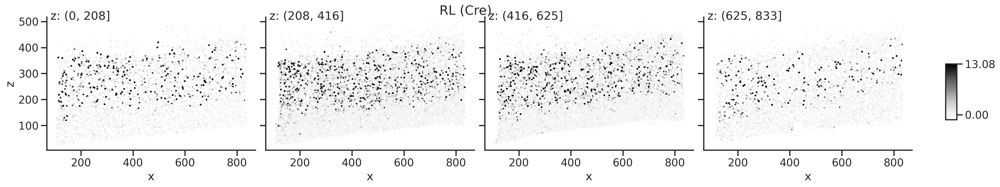

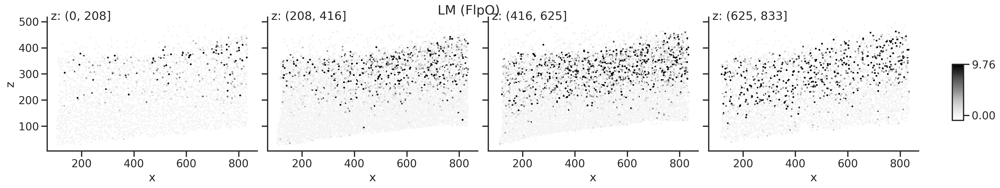

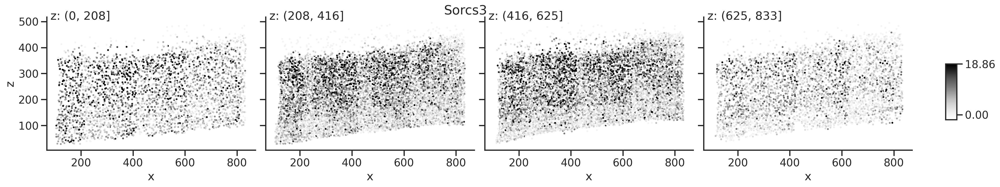

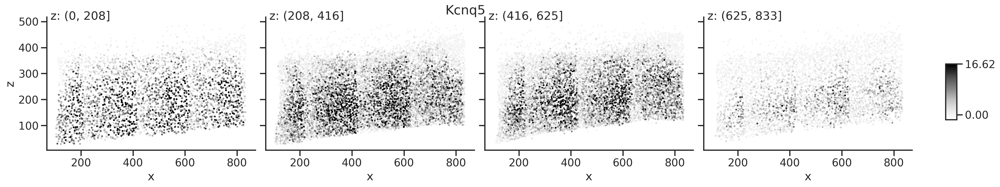

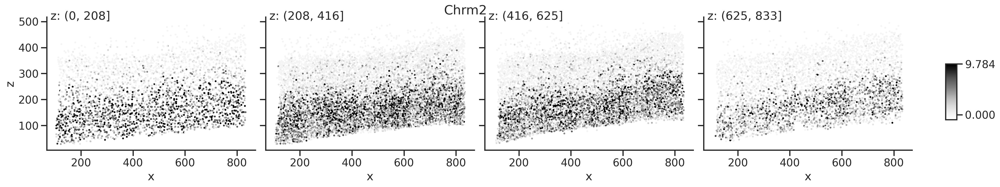

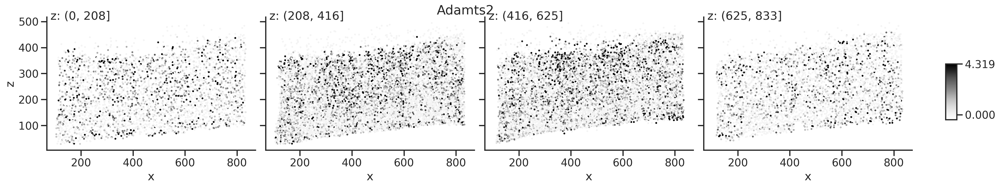

In [21]:
for col in ftrs_order:
    # col = ftrs_order[0]
    title = gene_names[col]

    # sp_x, sp_y, groupby = 'x', 'z', 'bins_yb'
    # view_z_sections(dfnew, sp_x, sp_y, groupby=groupby, col=col, cmap='Greys', title=title)

    sp_x, sp_y, groupby = 'x', 'z', 'bins_yb_4p'
    view_z_sections_4panels(dfnew, sp_x, sp_y, groupby=groupby, col=col, cmap='Greys', title=title, figsize=(4*6,1*4))

# hierarchical clustering

In [22]:
def gen_discrete_colors(N, cmap=matplotlib.cm.jet):
    """
    """
    fig, ax = plt.subplots(figsize=(6, 1))
    fig.subplots_adjust(bottom=0.5)
    norm = matplotlib.colors.BoundaryNorm(1+np.arange(N), cmap.N, extend='max')
    dismap = matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap)
    fig.colorbar(dismap,
                 cax=ax, orientation='horizontal')
    plt.show()
    
    palette = {i: dismap.to_rgba(i)[:3] for i in 1+np.arange(N)}
    plt.figure(figsize=(5,1))
    plt.scatter(1+np.arange(N), [0]*N, c=[palette[p] for p in palette.keys()])
    plt.show()
    return palette, dismap

(22654,) (5,)
(22654,) (13,)
(22654,) (24,)


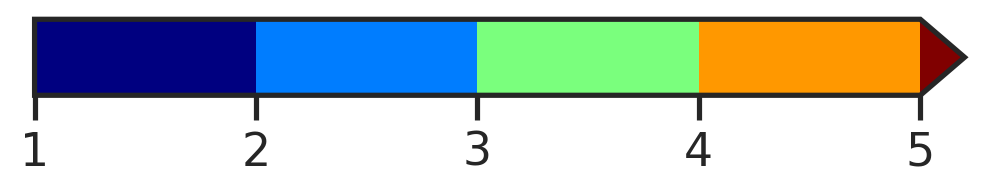

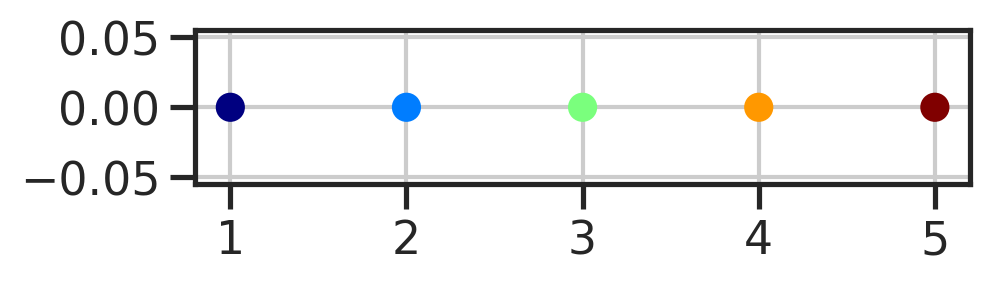

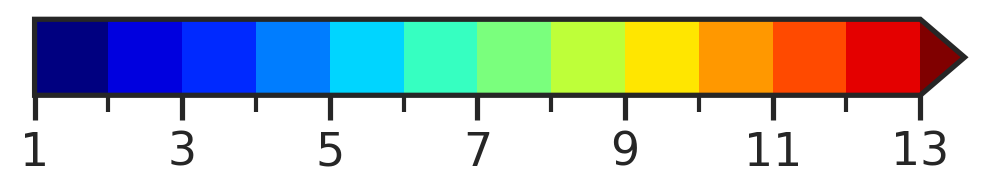

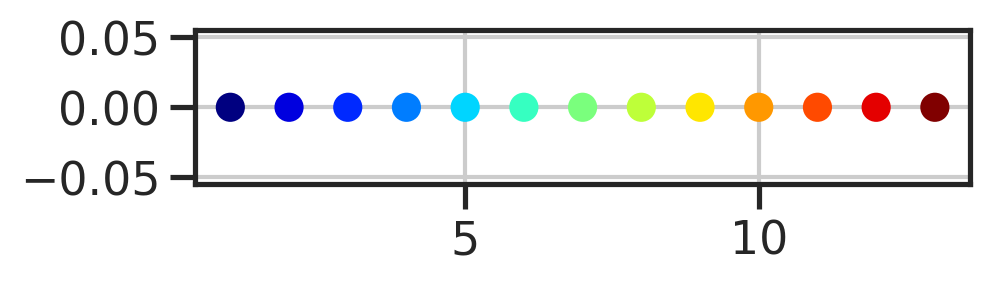

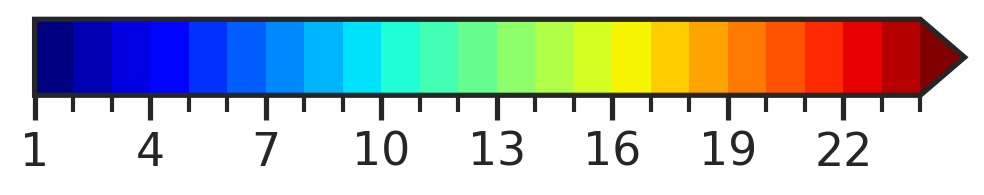

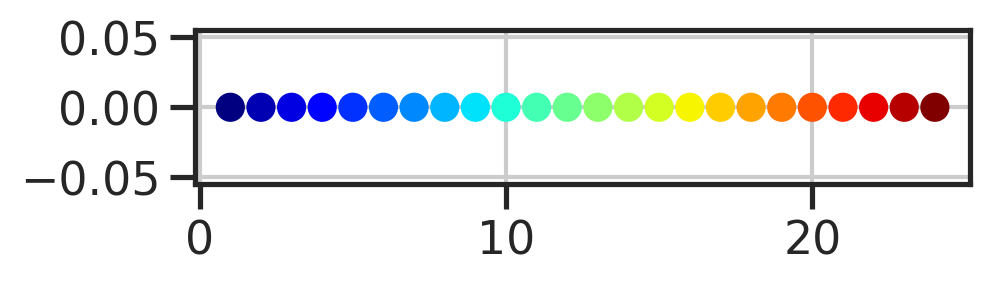

In [23]:
# sch
col_link = sch.linkage(mat_ftrs.T, method='ward', metric='euclidean')
col_order = sch.dendrogram(col_link, no_plot=True)['leaves']

row_link = sch.linkage(mat_ftrs, method='ward', metric='euclidean')
row_order = sch.dendrogram(row_link, p=30, truncate_mode='none', no_plot=True)['leaves']

# get clusters
clsts1 = sch.fcluster(row_link, 100, criterion='distance')
clsts2 = sch.fcluster(row_link,  50, criterion='distance')
clsts3 = sch.fcluster(row_link,  30, criterion='distance')

print(clsts1.shape, np.unique(clsts1).shape)
print(clsts2.shape, np.unique(clsts2).shape)
print(clsts3.shape, np.unique(clsts3).shape)

dfnew['clst_l1'] = clsts1
dfnew['clst_l2'] = clsts2
dfnew['clst_l3'] = clsts3

# colors
palette1, dismap1 = gen_discrete_colors(len(np.unique(clsts1)))
palette2, dismap2 = gen_discrete_colors(len(np.unique(clsts2)))
palette3, dismap3 = gen_discrete_colors(len(np.unique(clsts3)))

In [24]:
genes_order_v2 = np.hstack([
    mat_ftrs.columns[col_order],
    mat_cre.columns,
    # ['RL'],
])
ftrs_order_v2 = channel_names.loc[genes_order_v2].values
ftrs_order_v2

array(['r2_c1', 'r2_c2', 'r2_c0', 'r2_c4', 'r1_c0', 'r1_c2'], dtype=object)

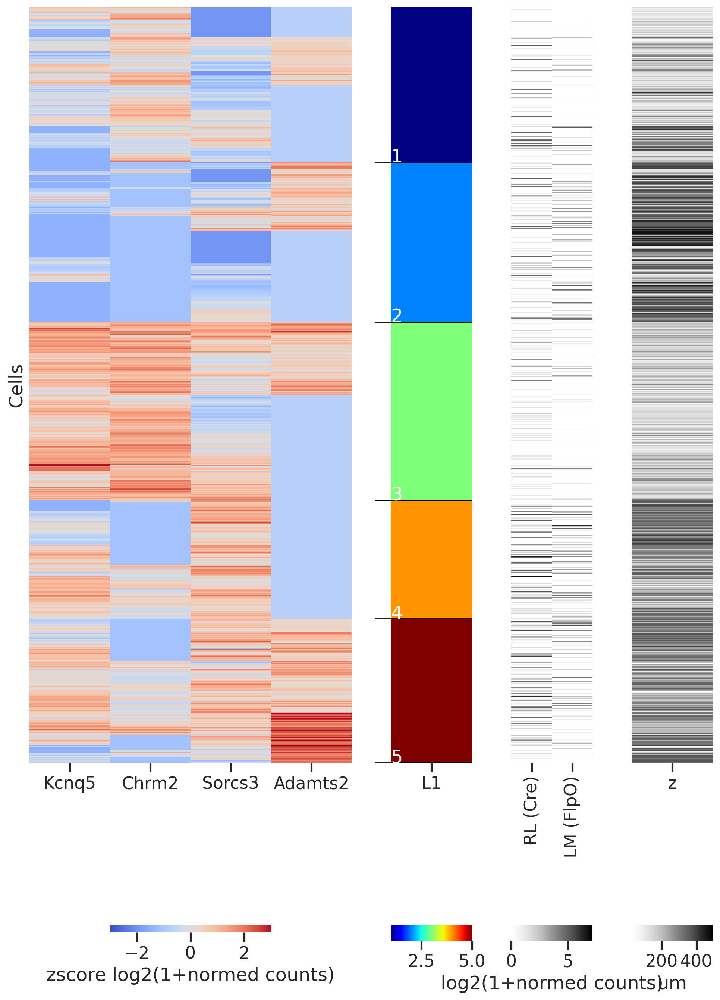

In [25]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*3+"BEF")
ax = axd["A"]
sns.heatmap(
    mat_ftrs.iloc[row_order,col_order],
    yticklabels=False,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+normed counts)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')

for i, (ax, col) in enumerate(zip(
    (axd["B"],),# axd["C"], axd["D"]),
    ('clst_l1',),# 'clst_l2', 'clst_l3'),
    )):
    vec = dfnew[col].values
    sns.heatmap(
        dfnew[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label=''),
        ax=ax,
    )
    ax.set_ylabel('')
    positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    for i, pos in enumerate(positions):
        ax.text(0, pos, i+1, color='white')

ax = axd["E"]
sns.heatmap(
    mat_cre.iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='log2(1+normed counts)'),
    ax=ax,
)
ax.set_ylabel('')

ax = axd["F"]
sns.heatmap(
    dfnew[['z']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
fig.tight_layout()

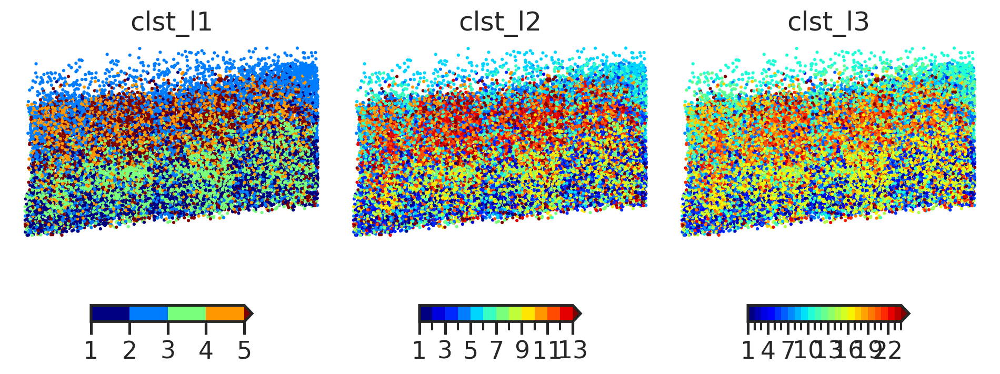

In [26]:
sp_x, sp_y = 'x', 'z'
fig, axs = plt.subplots(1,3,figsize=(4*3,5*1), sharey=True, sharex=True)
# cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, palette, dismap, ax) in enumerate(zip(['clst_l1', 'clst_l2', 'clst_l3'], 
                                                   [ palette1,  palette2,  palette3],
                                                   [ dismap1,   dismap2,   dismap3],
                                                   axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=pd.Series(palette)[c], s=5, edgecolor='none',)
    sns.despine(ax=ax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.colorbar(dismap, ax=ax, orientation='horizontal', shrink=0.5, aspect=10)
    
fig.subplots_adjust(hspace=0.1, wspace=0.02)

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1062: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


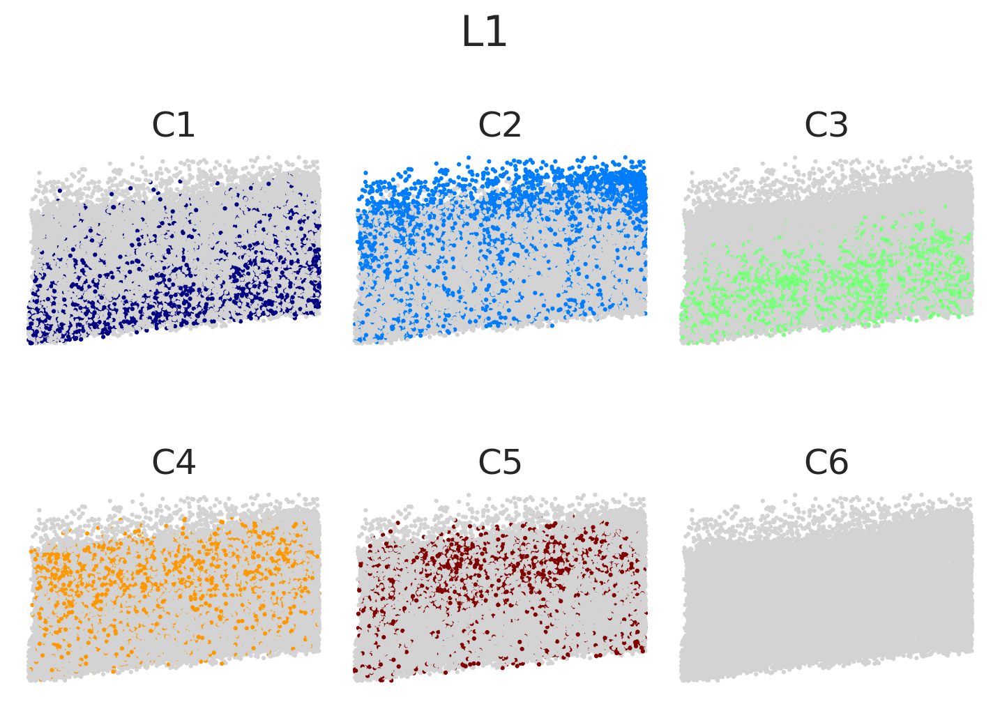

In [27]:
sp_x, sp_y = 'x', 'z'
col = 'clst_l1'
palette = palette1
dismap = dismap1
n = len(dfnew[col].unique())
nx = min(3,n)
ny = int((n+nx-1)/nx)
suptitle = 'L1'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

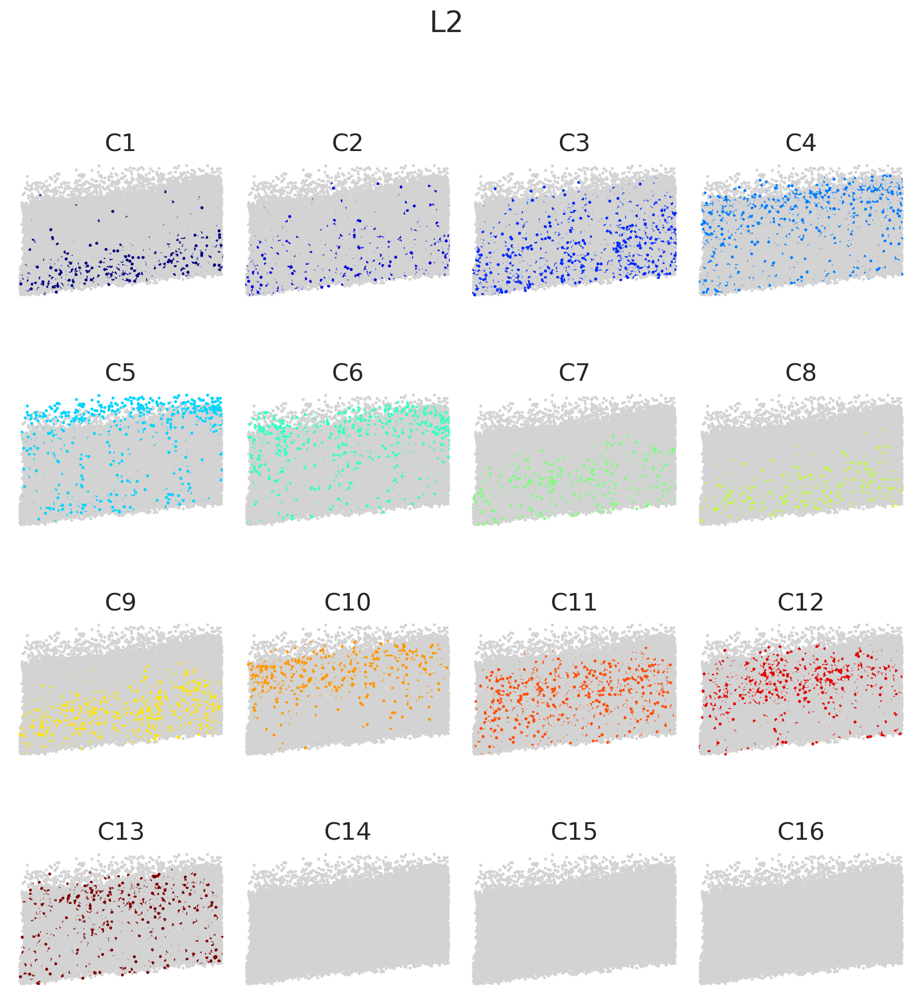

In [28]:
sp_x, sp_y = 'x', 'z'
col = 'clst_l2'
palette = palette2
dismap = dismap2
n = len(dfnew[col].unique())
nx = min(4,n)
ny = int((n+nx-1)/nx)
suptitle = 'L2'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

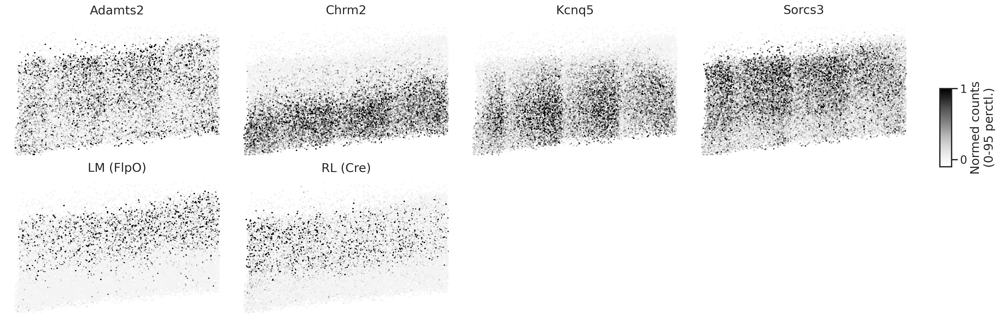

In [29]:
sp_x, sp_y = 'x', 'z'
fig, axs = plt.subplots(2,4,figsize=(6*4,4*2), sharey=True, sharex=True)
cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, ax) in enumerate(zip(ftrs_order[::-1], axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    vmax=np.percentile(c, 95)
    
    ax.axis('off')
    ax.grid(False)
    g = ax.scatter(x, y, c=c/vmax, s=5, edgecolor='none', cmap='Greys', vmax=1, vmin=-0.1) #vmax, vmin=-0.1*vmax)
    sns.despine(ax=ax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')

for ax in axs.flat[i:]:
    ax.axis('off')
    
fig.colorbar(g, cax=cbar_ax, label='Normed counts\n(0-95 perctl.)', aspect=5, shrink=0.3, ticks=[0, 1])
fig.subplots_adjust(hspace=0.1, wspace=0.02)

In [30]:
condp = ((df['r1_c0'] >= 9) | (df['r1_c2'] >= 7))
mat_ftrs_subp = mat_ftrs[condp]
mat_ftrs_subp

/tmp/ipykernel_34831/662786570.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  mat_ftrs_subp = mat_ftrs[condp]


,Sorcs3,Kcnq5,Chrm2,Adamts2
2,0.966640,-0.273976,-0.256934,1.141068
17,0.760724,1.291853,-0.370494,0.924285
27,0.134451,0.868607,-0.082503,0.337385
34,2.061666,0.685156,-1.107001,-0.764411
45,0.288074,-0.818197,-0.380175,-0.764411
...,...,...,...,...
27907,-0.327154,0.337226,0.538982,2.116277
27914,-0.137789,-0.606942,-0.143956,-0.764411
28058,-1.940968,-1.468212,-1.107001,-0.764411
28121,0.313131,0.849940,-1.107001,-0.764411


In [31]:
dfnew_sub = dfnew[condp].copy()
dfnew_sub['proj'] = ((df['r1_c0']>=9).astype(int) + 2*(df['r1_c2']>=7).astype(int))[condp]
dfnew_sub

/tmp/ipykernel_34831/3701651438.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfnew_sub = dfnew[condp].copy()


,r1_c0,r1_c2,r2_c0,r2_c1,r2_c2,r2_c4,z,y,x,area,...,r2_c0_log2,r2_c1_log2,r2_c2_log2,r2_c4_log2,bins_yb,bins_yb_4p,clst_l1,clst_l2,clst_l3,proj
2,22.698271,0.000000,11.889571,2.161740,1.080870,2.161740,346.164196,365.227001,155.285191,3824.339904,...,3.688132,1.660719,1.057187,1.660719,"(312, 416]","(208, 416]",5,12,21,1
17,12.415497,0.000000,9.755034,13.302318,0.886821,1.773642,240.780357,176.704832,262.896034,2330.579328,...,3.426940,3.838177,0.915958,1.471782,"(104, 208]","(0, 208]",5,12,21,1
27,17.967794,0.000000,5.201204,8.511061,1.418510,0.945673,251.450124,148.710488,511.257677,4371.080448,...,2.632548,3.249606,1.274119,0.960270,"(104, 208]","(0, 208]",5,12,21,1
34,31.362982,9.060417,32.756893,6.969552,0.000000,0.000000,308.354021,138.614069,172.383208,2965.480896,...,5.077110,2.994499,0.000000,0.000000,"(104, 208]","(0, 208]",4,11,18,3
45,27.876536,0.000000,6.097992,0.871142,0.871142,0.000000,197.270018,388.199197,237.655823,2372.526912,...,2.827411,0.903919,0.903919,0.000000,"(312, 416]","(208, 416]",1,3,6,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27907,0.000000,29.759159,3.132543,4.698815,3.132543,4.698815,240.448248,422.490668,250.272716,1319.571456,...,2.047030,2.510662,2.047030,2.510662,"(416, 520]","(416, 625]",5,12,21,2
27914,0.000000,14.230975,3.881175,1.293725,1.293725,0.000000,366.697171,729.433075,597.228625,1597.563072,...,2.287228,1.197692,1.197692,0.000000,"(729, 833]","(625, 833]",1,3,6,2
28058,5.386658,30.524398,0.000000,0.000000,0.000000,0.000000,295.560341,214.868586,131.302582,1151.070144,...,0.000000,0.000000,0.000000,0.000000,"(208, 312]","(208, 416]",2,5,10,2
28121,15.640244,2.085366,6.256098,8.341463,0.000000,0.000000,175.834473,419.109168,147.849742,1982.201088,...,2.859194,3.223649,0.000000,0.000000,"(416, 520]","(416, 625]",4,11,18,1


(3068,) (3,)
(3068,) (4,)
(3068,) (4,)


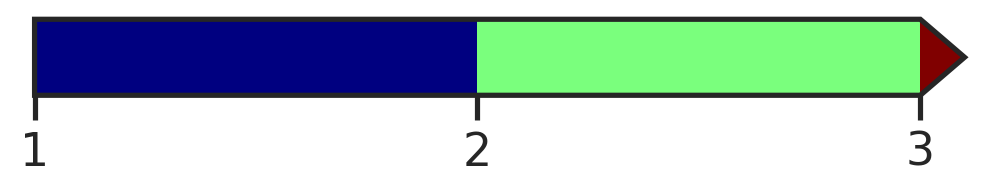

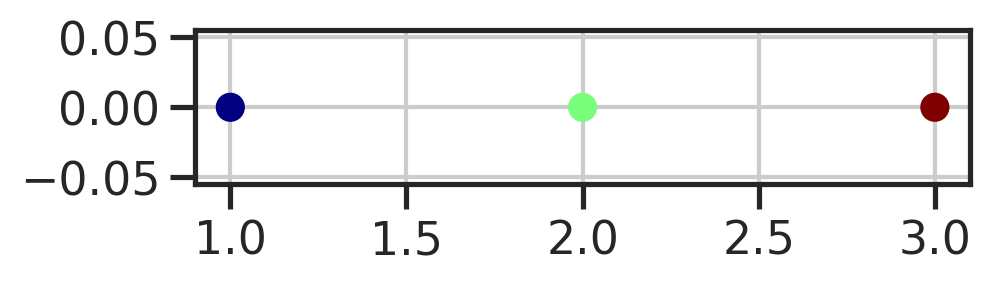

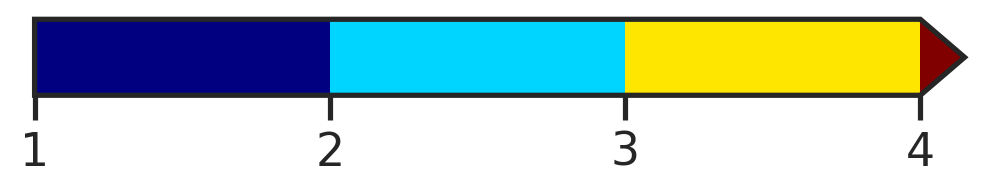

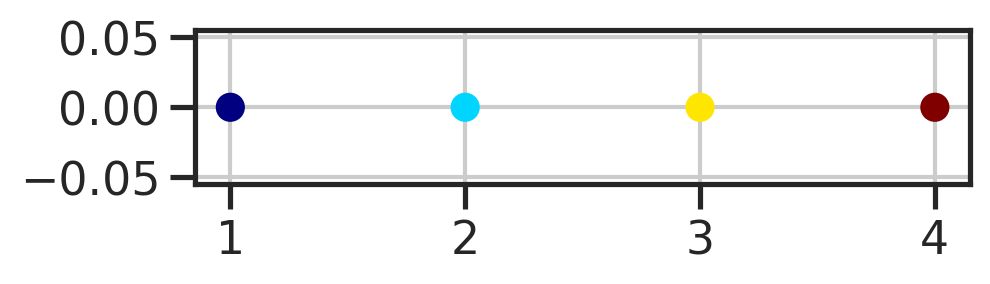

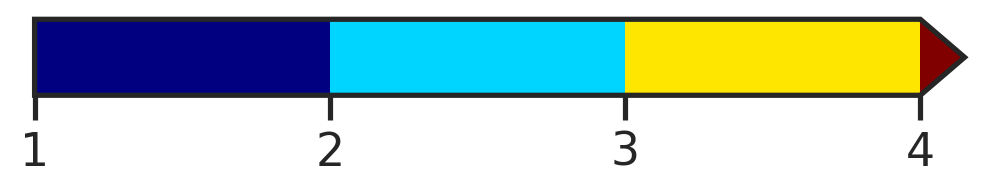

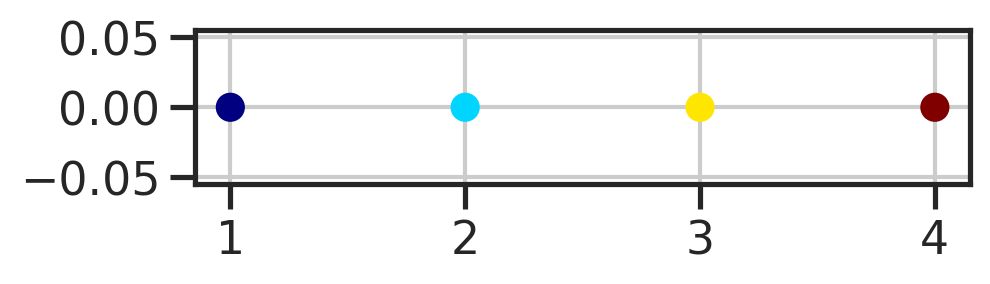

In [32]:
# sch
col_link = sch.linkage(mat_ftrs_subp.T, method='ward', metric='euclidean')
col_order = sch.dendrogram(col_link, no_plot=True)['leaves']

row_link = sch.linkage(mat_ftrs_subp, method='ward', metric='euclidean')
row_order = sch.dendrogram(row_link, p=30, truncate_mode='none', no_plot=True)['leaves']

# get clusters
clsts1 = sch.fcluster(row_link,  45, criterion='distance')
clsts2 = sch.fcluster(row_link,  40, criterion='distance')
clsts3 = sch.fcluster(row_link,  35, criterion='distance')

print(clsts1.shape, np.unique(clsts1).shape)
print(clsts2.shape, np.unique(clsts2).shape)
print(clsts3.shape, np.unique(clsts3).shape)

dfnew_sub['clst_l1'] = clsts1
dfnew_sub['clst_l2'] = clsts2
dfnew_sub['clst_l3'] = clsts3

# colors
palette1, dismap1 = gen_discrete_colors(len(np.unique(clsts1)))
palette2, dismap2 = gen_discrete_colors(len(np.unique(clsts2)))
palette3, dismap3 = gen_discrete_colors(len(np.unique(clsts3)))

/tmp/ipykernel_34831/1083607978.py:34: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  mat_cre[condp].iloc[row_order],


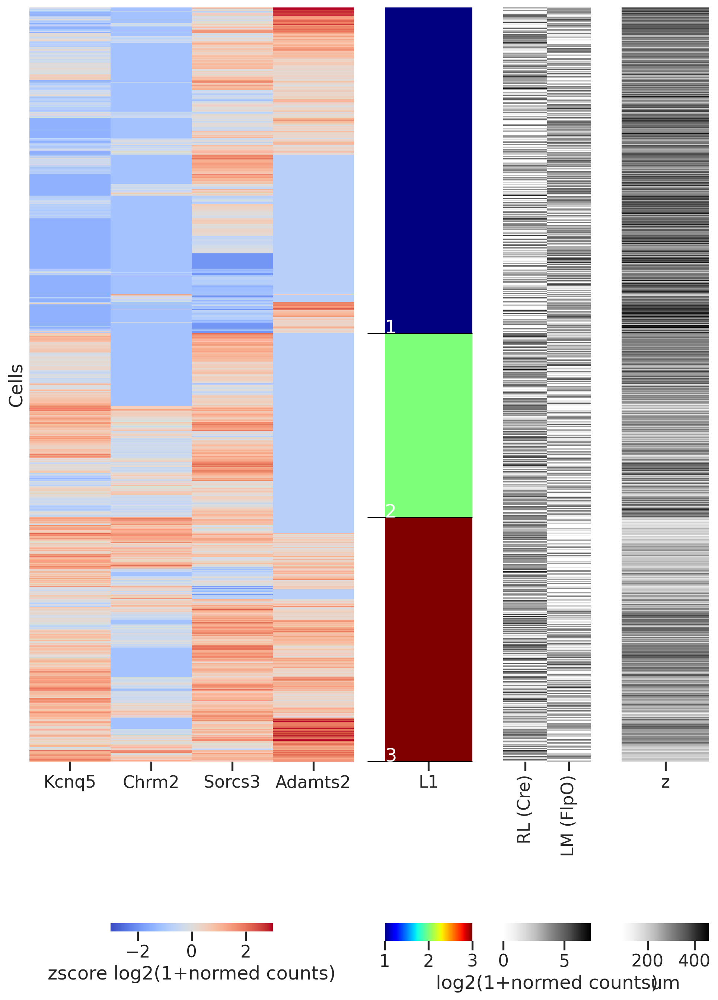

In [33]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*3+"BEF")
ax = axd["A"]
sns.heatmap(
    mat_ftrs_subp.iloc[row_order,col_order],
    yticklabels=False,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+normed counts)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')

for i, (ax, col) in enumerate(zip(
    (axd["B"],),# axd["C"], axd["D"]),
    ('clst_l1',),# 'clst_l2', 'clst_l3'),
    )):
    vec = dfnew_sub[col].values
    sns.heatmap(
        dfnew_sub[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label=''),
        ax=ax,
    )
    ax.set_ylabel('')
    positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    for i, pos in enumerate(positions):
        ax.text(0, pos, i+1, color='white')

ax = axd["E"]
sns.heatmap(
    mat_cre[condp].iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='log2(1+normed counts)'),
    ax=ax,
)
ax.set_ylabel('')

ax = axd["F"]
sns.heatmap(
    dfnew_sub[['z']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
fig.tight_layout()

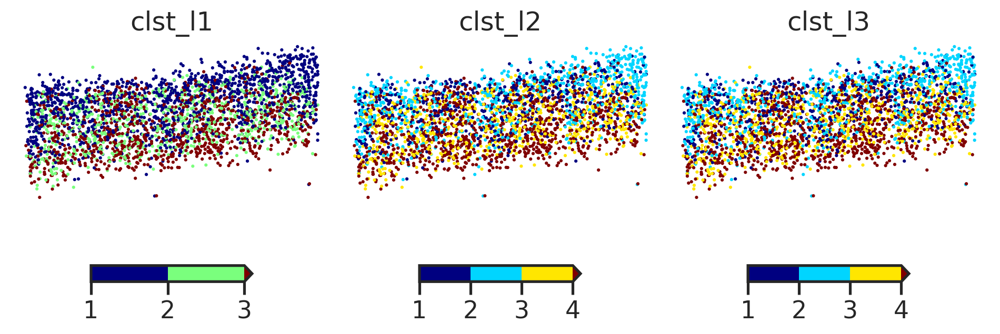

In [34]:
sp_x, sp_y = 'x', 'z'
fig, axs = plt.subplots(1,3,figsize=(4*3,5*1), sharey=True, sharex=True)
# cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, palette, dismap, ax) in enumerate(zip(['clst_l1', 'clst_l2', 'clst_l3'], 
                                                   [ palette1,  palette2,  palette3],
                                                   [ dismap1,   dismap2,   dismap3],
                                                   axs.flat)):
    x = dfnew_sub[sp_x].values
    y = dfnew_sub[sp_y].values
    c = dfnew_sub[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=pd.Series(palette)[c], s=5, edgecolor='none',)
    sns.despine(ax=ax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.colorbar(dismap, ax=ax, orientation='horizontal', shrink=0.5, aspect=10)
    
fig.subplots_adjust(hspace=0.1, wspace=0.02)

/tmp/ipykernel_34831/2395413526.py:18: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  g = ax.scatter(x[c==i+1], y[c==i+1], c=palette[i+1], s=4, edgecolor='none',)


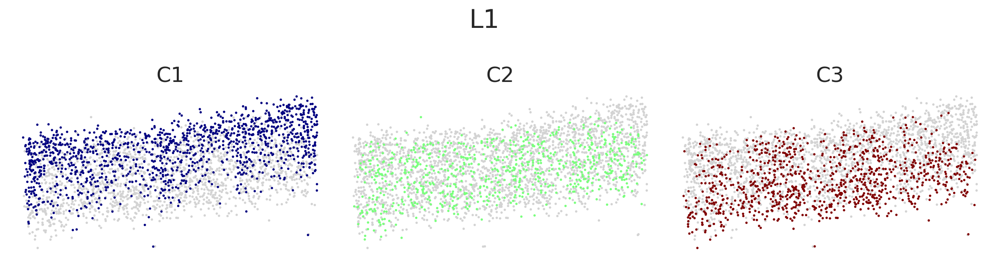

In [57]:
sp_x, sp_y = 'x', 'z'
col = 'clst_l1'
palette = palette1
dismap = dismap1
n = len(dfnew_sub[col].unique())
nx = min(3,n)
ny = int((n+nx-1)/nx)
suptitle = 'L1'

fig, axs = plt.subplots(ny,nx,figsize=(5*nx,4*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew_sub[sp_x].values
    y = dfnew_sub[sp_y].values
    c = dfnew_sub[col].values
    
    ax.grid(False)
    g = ax.scatter(x[c!=i+1], y[c!=i+1], c='lightgray',  s=4, edgecolor='none',)
    g = ax.scatter(x[c==i+1], y[c==i+1], c=palette[i+1], s=4, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

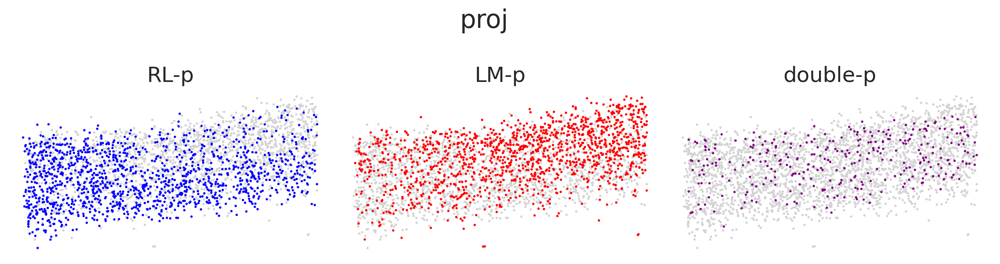

In [62]:
sp_x, sp_y = 'x', 'z'
col = 'proj'
n = len(dfnew_sub[col].unique())
nx = min(3,n)
ny = int((n+nx-1)/nx)
suptitle = 'proj'

proj_lbls = ['RL-p', 'LM-p', 'double-p']
palette = {1: 'blue', 2: 'red', 3: 'purple'}
palette_proj = {'RL-p': 'blue', 'LM-p': 'red', 'double-p': 'purple'}

fig, axs = plt.subplots(ny,nx,figsize=(5*nx,4*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew_sub[sp_x].values
    y = dfnew_sub[sp_y].values
    c = dfnew_sub[col].values
    
    ax.grid(False)
    g = ax.scatter(x[c!=i+1], y[c!=i+1], c='lightgray',  s=4, edgecolor='none',)
    g = ax.scatter(x[c==i+1], y[c==i+1], c=palette[i+1], s=4, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(proj_lbls[i])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

In [63]:
namedict = {1: 'RL-p', 2: 'LM-p', 3: 'double-p'}
dfnew_sub['proj_name'] = dfnew_sub['proj'].apply(lambda x: namedict[x])
t2p_counts = dfnew_sub.groupby(['clst_l1', 'proj_name']).size().unstack() #].()
t2p_counts

proj_name,LM-p,RL-p,double-p
clst_l1,,,
1,752,439,133
2,288,373,89
3,350,543,101


In [64]:
t2p_freq_proj = t2p_counts.divide(t2p_counts.sum(axis=0), axis=1)
t2p_freq_type = t2p_counts.divide(t2p_counts.sum(axis=1), axis=0)

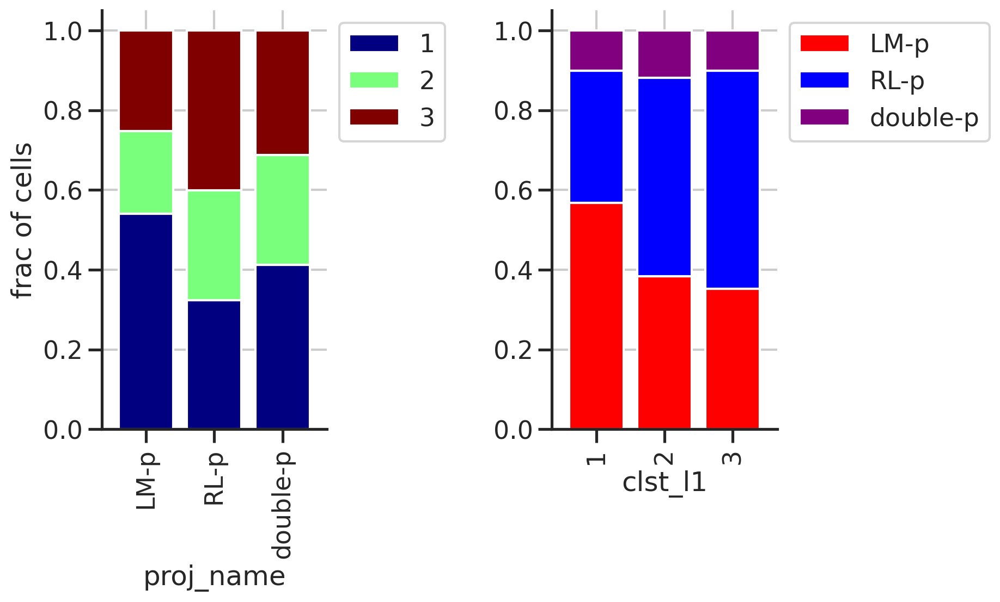

In [65]:
fig, axs = plt.subplots(1,2,figsize=(4*2,5))
ax = axs[0]
t2p_freq_proj.T.plot.bar(stacked=True, ax=ax, width=0.8, color=palette1)
sns.despine(ax=ax)
ax.set_ylabel('frac of cells')
ax.legend(bbox_to_anchor=(1,1))

ax = axs[1]
t2p_freq_type.plot.bar(stacked=True, ax=ax, width=0.8, color=palette_proj)
sns.despine(ax=ax)
ax.legend(bbox_to_anchor=(1,1))
fig.subplots_adjust(wspace=1)
plt.show()

<Axes: xlabel='clst_l1'>

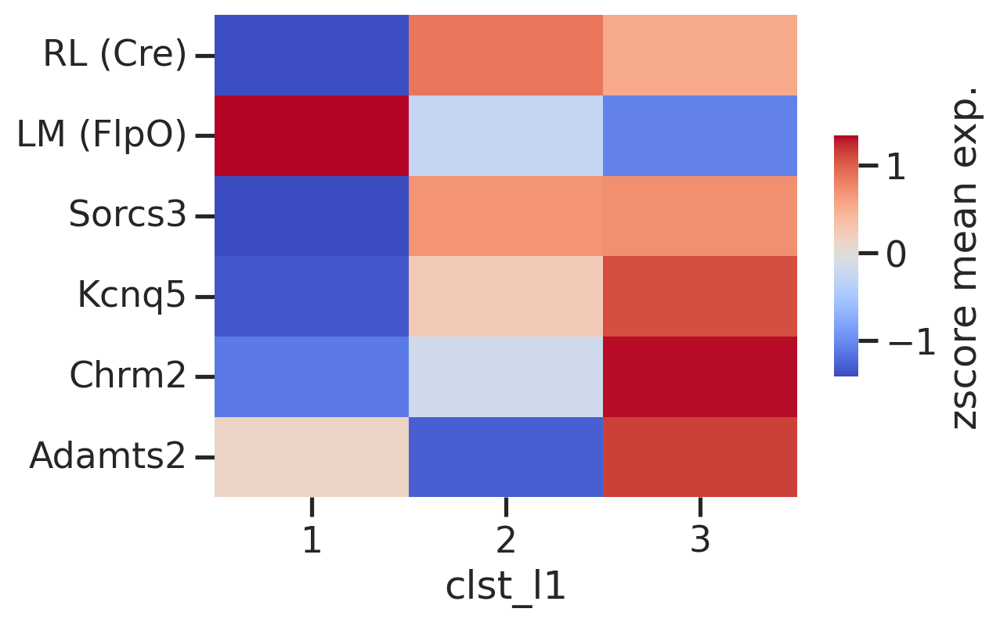

In [66]:
group = 'clst_l1'
dfmean = dfnew_sub.groupby(group)[ftrs_order].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(dfmean.T, ax=ax, 
            yticklabels=[gene_names[col] for col in dfmean.columns],
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

# co-expression, clustering, cluster enrichment of expression

/tmp/ipykernel_22528/385544519.py:24: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col,


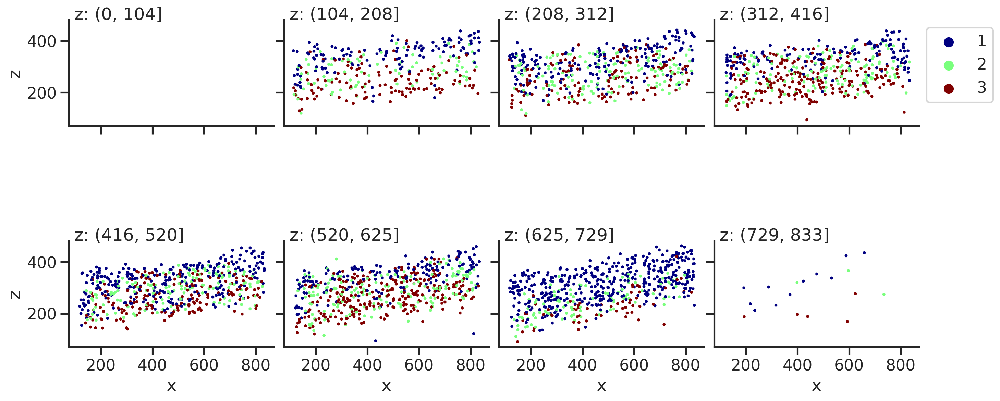

In [96]:
sp_x, sp_y, groupby = 'x', 'z', 'bins_yb'
col = 'clst_l1'
view_z_sections_labels(dfnew_sub, sp_x, sp_y, col, groupby=groupby, palette=palette1, title=None)

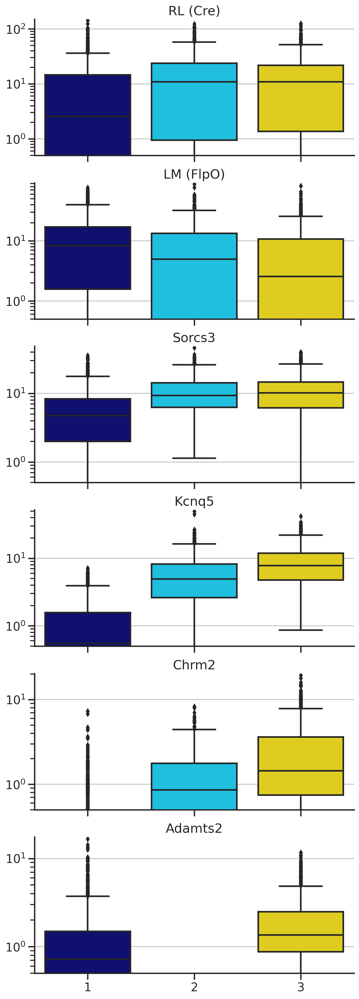

In [97]:
group = 'clst_l1'
palette = palette2
data = dfnew_sub

fig, axs = plt.subplots(6,1,figsize=(8*1,4*6), sharex=True)
grouporder = np.unique(data[group])
for i, col in enumerate(ftrs_order):
    ax = axs.flat[i]
    # col = ftrs_order[0]

    sns.boxplot(data=data, x=group, order=grouporder, palette=palette, y=col, ax=ax,)
    sns.despine(ax=ax)
    ax.set_ylim(ymin=0.5)
    ax.set_title(gene_names[col])
    ax.set_ylabel("") #gene_names[col])
    ax.set_xlabel("") #gene_names[col])
    ax.set_yscale('log')
fig.subplots_adjust(wspace=0.3)

<Axes: xlabel='clst_l1'>

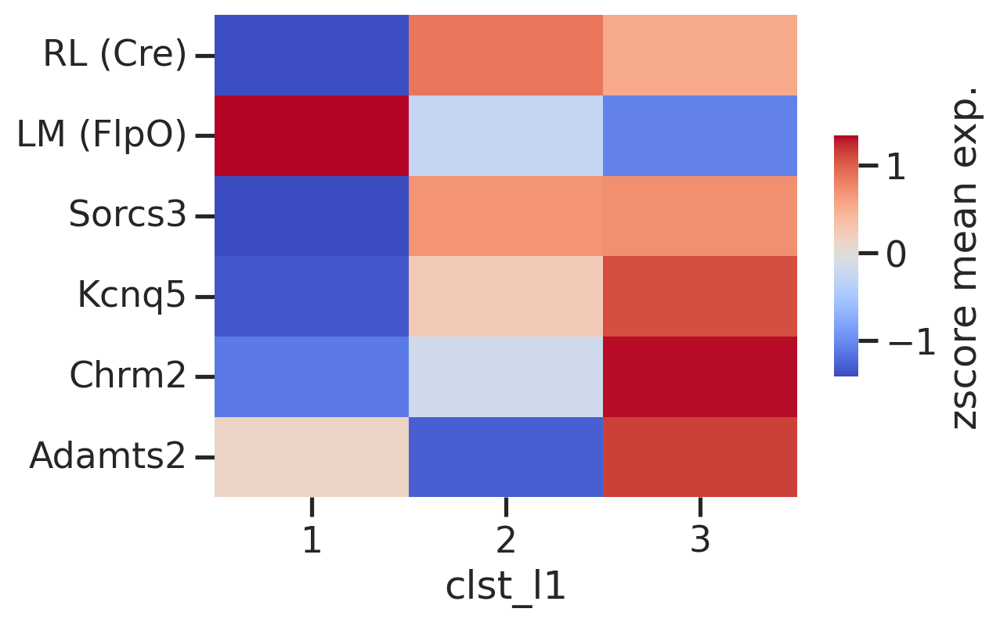

In [99]:
group = 'clst_l1'
dfmean = dfnew_sub.groupby(group)[ftrs_order].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(dfmean.T, ax=ax, 
            yticklabels=[gene_names[col] for col in dfmean.columns],
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

# correlate

In [35]:
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression

In [36]:
def plot_corr(x, y, ax, ylabel=True):
    """
    """
    ax.scatter(x, y, s=1)
    r, p = spearmanr(x, y)
    ax.set_xlabel(x.name)
    if ylabel:
        ax.set_ylabel(y.name)
    ax.set_title(f"r={r:.2f}, p={p:.2g}")
    
    _df = pd.DataFrame(np.vstack([x, y]).T)
    _df[2] = pd.qcut(_df[0], 20, duplicates='drop')
    _df = _df.groupby(2).mean()
    ax.plot(_df[0], _df[1], color='C1')
    
    return 

In [37]:
mat_ftrs2 = dfnew.filter(regex='_log2$').filter(regex='^((?!r1).)*$') #.columns
mat_ftrs2.columns = [gene_names[col[:-len('_log2')]] for col in mat_ftrs2.columns]

mat_cre2 = dfnew.filter(regex='_log2$').filter(regex='^r1.*$') #.columns
mat_cre2.columns = [gene_names[col[:-len('_log2')]] for col in mat_cre2.columns]

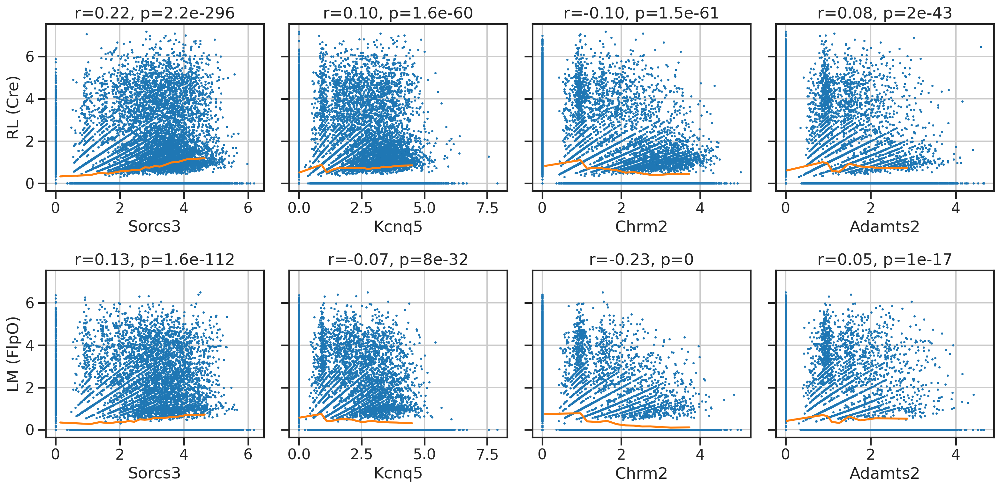

In [38]:
fig, axs = plt.subplots(2,4,figsize=(4*4,2*4), sharey=True)
for i in range(mat_ftrs2.shape[1]):
    for j in range(mat_cre2.shape[1]):
        ax = axs[j,i]
        _x = mat_ftrs2.iloc[:,i] 
        _y = mat_cre2.iloc[:,j]

        if i % 4 == 0:
            ylabel = True
        else:
            ylabel = False
        plot_corr(_x, _y, ax, ylabel=ylabel)
fig.tight_layout()

In [39]:
lr = LinearRegression()
lr.fit(mat_ftrs2.values, mat_cre2.values)
r2 = lr.score(mat_ftrs2.values, mat_cre2.values)
ypred = lr.predict(mat_ftrs2)
ypred = pd.Series(ypred[:,0], name='pred')
r2

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/sklearn/base.py:432: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


0.07306970507424637

In [40]:
hybrid_ftrs = np.hstack([mat_ftrs2, dfnew[['z']]/np.max(dfnew['z'])])
lr = LinearRegression()
lr.fit(hybrid_ftrs, mat_cre2.values)
r2 = lr.score(hybrid_ftrs, mat_cre2.values)
ypred2 = lr.predict(hybrid_ftrs)
ypred2 = pd.Series(ypred2[:,0], name='pred')
r2

0.09123075106625739

Text(0.5, 0, 'All genes (linear model)')

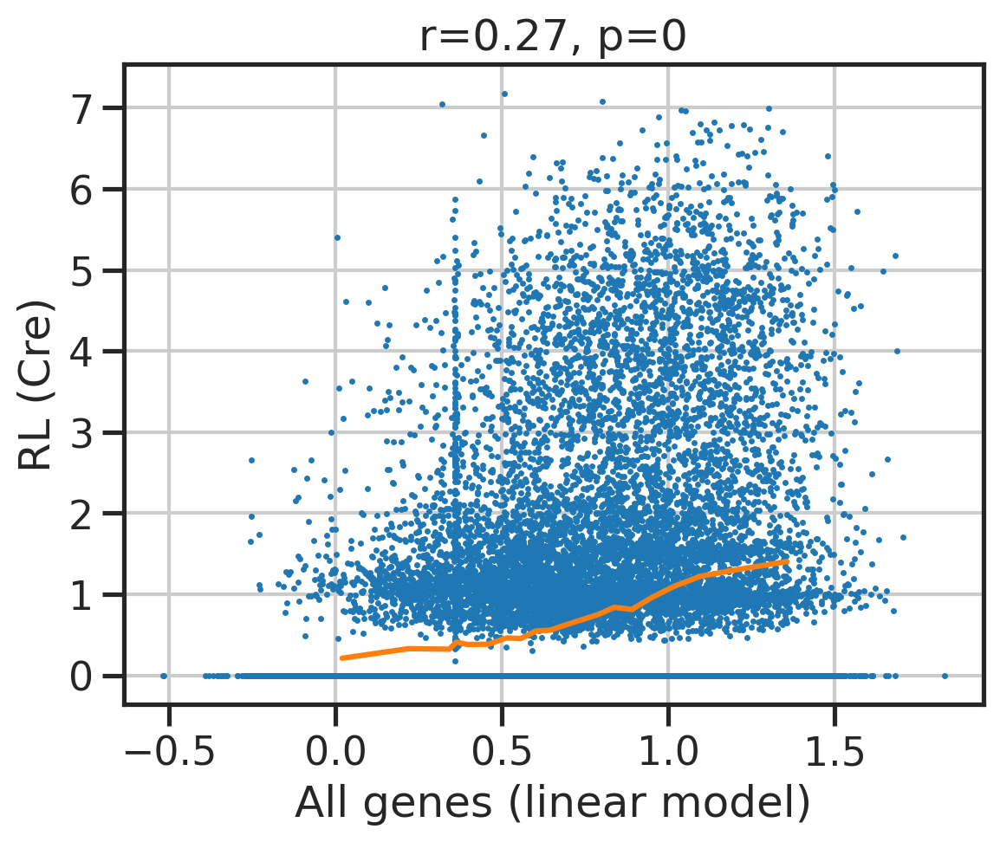

In [41]:
_x = ypred
_y = mat_cre2.iloc[:,0]

fig, ax = plt.subplots()
plot_corr(_x, _y, ax) #.iloc[:,0], ax)
ax.set_xlabel('All genes (linear model)')

Text(0.5, 0, 'All genes + y (linear model)')

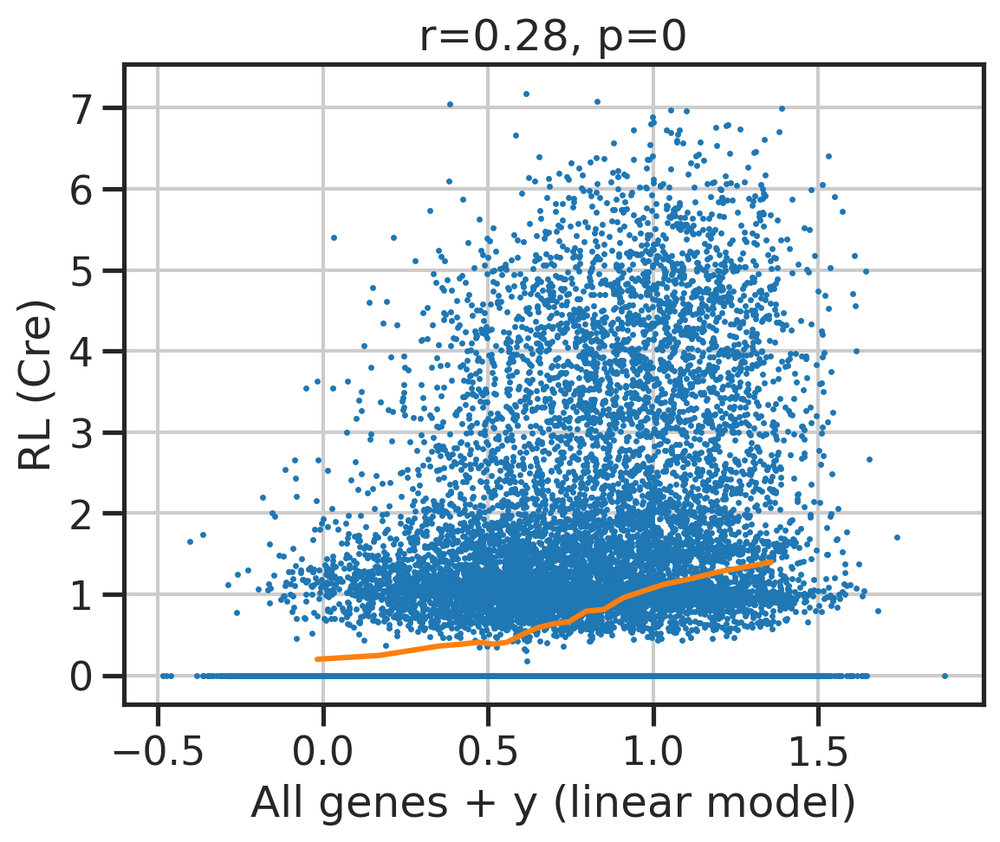

In [42]:
_x = ypred2
_y = mat_cre2.iloc[:,0]

fig, ax = plt.subplots()
plot_corr(_x, _y, ax) #.iloc[:,0], ax)
ax.set_xlabel('All genes + y (linear model)')

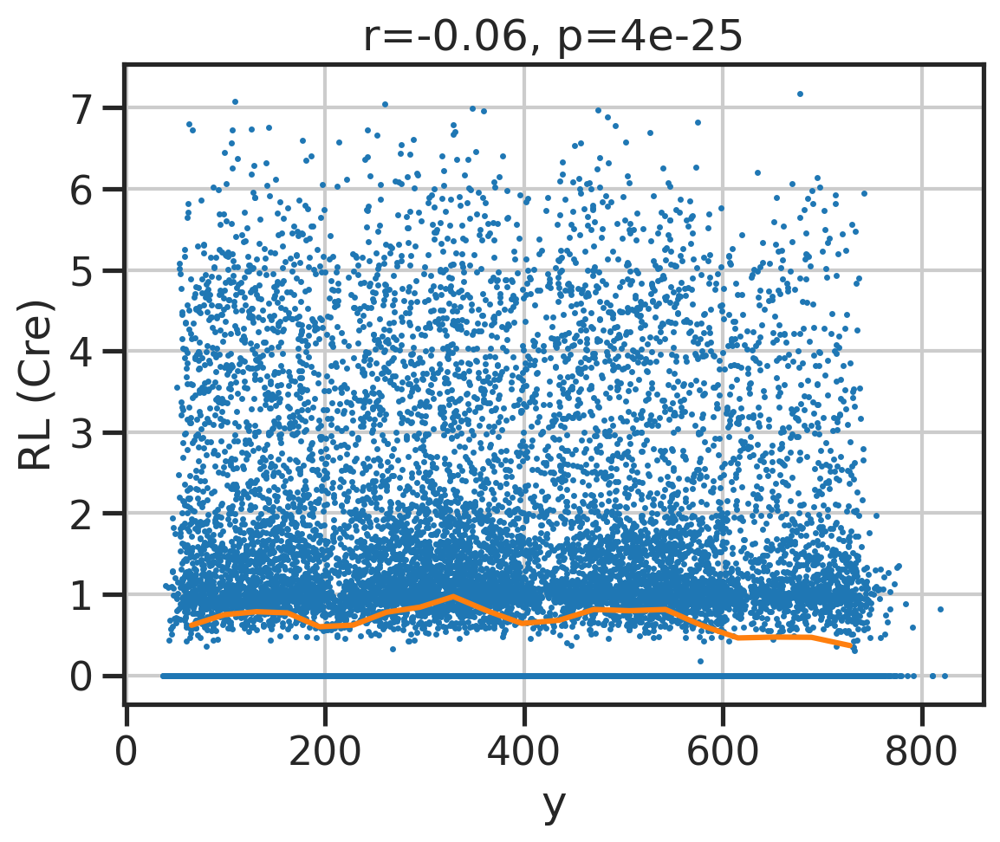

In [43]:
fig, ax = plt.subplots()
plot_corr(dfnew['y'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

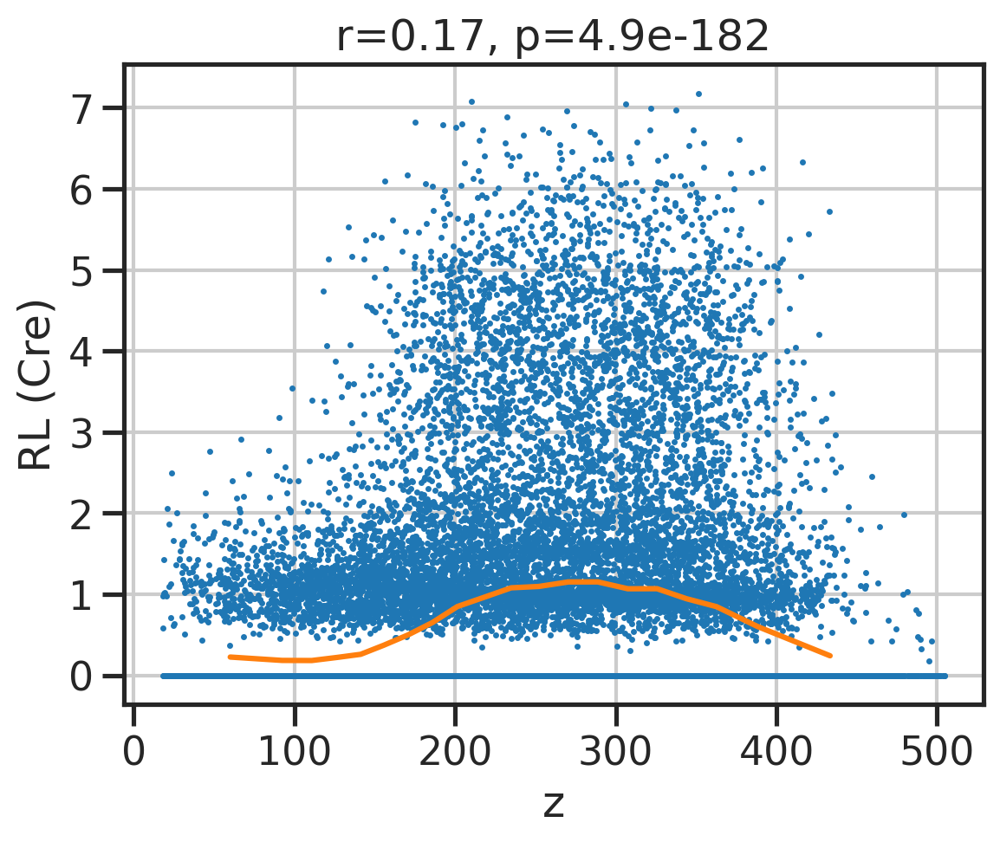

In [44]:
fig, ax = plt.subplots()
plot_corr(dfnew['z'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

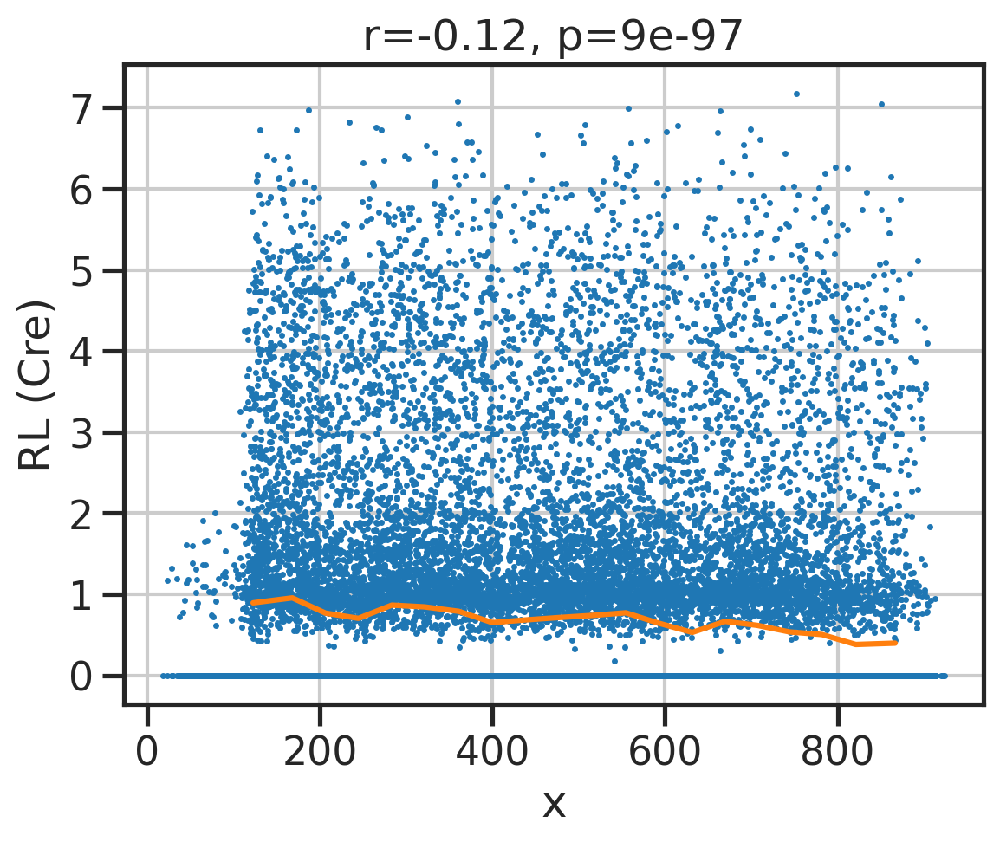

In [45]:
fig, ax = plt.subplots()
plot_corr(dfnew['x'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

# spatial analysis

In [46]:
def get_clst2clst_counts(clsts, knn):
    """Given cluster labels (for each cell) and spatial neighbors (indices; including self), 
    Calculate how many connections (neighbor pairs) each cluster pairs have.
    Return this information as a cluster-by-cluster count matrix
    
    `clsts` is an array of cluster labels (integers; start from zero and goes continuously up)
    """
    from scipy import sparse
    k = knn.shape[1]
    knn_clsts = clsts[knn] # cluster label for kNN
    n_unq_clsts = len(np.unique(clsts)) # number of clusters

    shape   = (n_unq_clsts, n_unq_clsts)
    _self   = knn_clsts[:,0]
    _others = knn_clsts[:,1:]
    rows = np.repeat(_self, (k-1)) # repeat 
    cols = np.hstack(_others)
    assert len(rows) == len(cols) 
    data = np.repeat(1, len(rows))
    clst2clst_counts = sparse.coo_matrix((data, (rows, cols)), shape=shape).todense() 
    clst2clst_counts = (clst2clst_counts + clst2clst_counts.T) # each connection counted twice.
    return clst2clst_counts

In [47]:
xyz = dfnew[['x', 'y', 'z']].values
clsts = dfnew['clst_l1'].values
unq_clsts = np.unique(clsts)
xyz, clsts, np.unique(clsts), xyz.shape, clsts.shape, unq_clsts

(array([[345.73875067, 118.02352376, 291.49491275],
        [155.28519056, 365.2270013 , 346.16419562],
        [504.98816275, 140.04924943, 160.62481375],
        ...,
        [492.55153494, 538.17836708, 197.346186  ],
        [134.48692737, 253.88089385, 422.80408202],
        [182.14523274, 308.87338684, 284.99908247]]),
 array([4, 3, 3, ..., 2, 1, 4], dtype=int32),
 array([1, 2, 3, 4, 5], dtype=int32),
 (28138, 3),
 (28138,),
 array([1, 2, 3, 4, 5], dtype=int32))

In [48]:
# for each cell, get their k nearest spatial neighbors
from sklearn.neighbors import NearestNeighbors
from statsmodels.stats.multitest import multipletests

k = 1+20 # 1(self) + n nearest neighbors
knn_fit = NearestNeighbors(n_neighbors=k).fit(xyz)
knn = knn_fit.kneighbors(xyz, return_distance=False)
print(knn.shape)

(28138, 21)


In [49]:
c2c_counts = get_clst2clst_counts(clsts-1, knn)
print(c2c_counts.shape)

Nshuff = 10 # 1000
c2c_counts_shuff_all = []
for i in range(Nshuff):
    clsts_shuff = clsts[np.random.choice(len(clsts), size=len(clsts), replace=False)]
    c2c_counts_shuff = get_clst2clst_counts(clsts_shuff-1, knn)
    c2c_counts_shuff_all.append(c2c_counts_shuff)
c2c_counts_shuff_all = np.array(c2c_counts_shuff_all)
c2c_counts_shuff_mean = np.mean(c2c_counts_shuff_all, axis=0)
print(c2c_counts_shuff_all.shape, c2c_counts_shuff_mean.shape)

(5, 5)
(10, 5, 5) (5, 5)


In [50]:
pvals = 1/Nshuff+1/Nshuff*2*np.minimum(np.sum(np.array([c2c_counts]) < c2c_counts_shuff_all, axis=0),
                                 np.sum(np.array([c2c_counts]) > c2c_counts_shuff_all, axis=0),
                                )
rejs, qvals, _, _ = multipletests(pvals.reshape(-1,), method='fdr_bh')
rejs  = rejs.reshape(pvals.shape)
qvals = qvals.reshape(pvals.shape)

In [51]:
enriched = np.log2((1+c2c_counts)/(1+c2c_counts_shuff_mean))
enriched[~rejs] = 0 #= enriched*rejs.astype(int)

In [52]:
links = sch.linkage(enriched, method='average')
clstidx_spatial_order = sch.dendrogram(links, no_plot=True)['leaves']
clstidx_spatial_order

/tmp/ipykernel_18889/3522773873.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  links = sch.linkage(enriched, method='average')


[4, 3, 2, 0, 1]

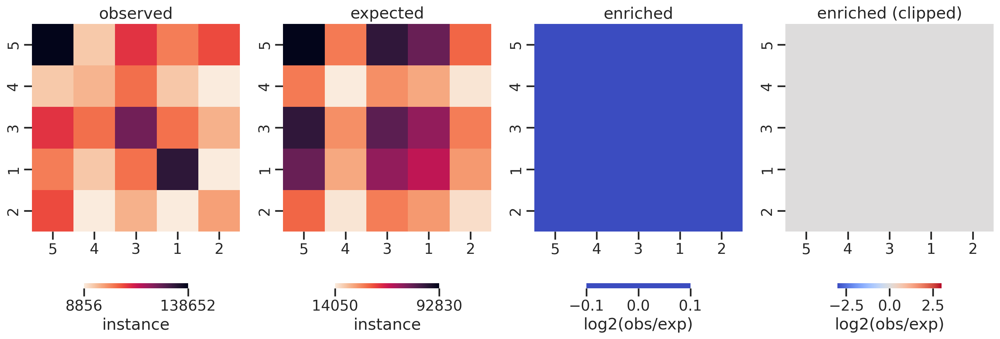

In [53]:
fig, axs = plt.subplots(1,4,figsize=(4*4,1*6))
ax = axs[0]
_min, _max = np.min(c2c_counts), np.max(c2c_counts)
sns.heatmap(c2c_counts[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax, 
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('observed')

ax = axs[1]
_min, _max = np.min(c2c_counts_shuff_mean), np.max(c2c_counts_shuff_mean)
sns.heatmap(c2c_counts_shuff_mean[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('expected')

ax = axs[2]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            # vmax=2,vmin=-2,
            center=0,
           )
ax.set_aspect('equal')
ax.set_title('enriched')

ax = axs[3]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            vmax=3,vmin=-3,
           )
ax.set_aspect('equal')
ax.set_title('enriched (clipped)')
fig.tight_layout()

# Save

In [54]:
output = os.path.join(pth_dat, "clustering_r1r2_230831.csv")
dfnew.to_csv(output)
!chmod 444 $output
# !head $output

In [55]:
palette1_ = {}
for i, item in palette1.items():
    palette1_[int(i)] = (matplotlib.colors.to_hex(item))
    
palette2_ = {}
for i, item in palette2.items():
    palette2_[int(i)] = (matplotlib.colors.to_hex(item))
    
palette3_ = {}
for i, item in palette3.items():
    palette3_[int(i)] = (matplotlib.colors.to_hex(item))

In [56]:
import json

output2 = os.path.join(pth_dat, "clustering_r1r2_config_230721.json")
config = {
    'gene_names': gene_names,
    'palette1':   palette1_,
    'palette2':   palette2_,
    'palette3':   palette3_,
}

with open(output2, 'w') as fh:
    json.dump(config, fh)
!chmod 444 $output2